---
format: 
  html:
    toc: false
    page-layout: full
execute:
    echo: false
---

# Home & Job Distribution

In [1]:
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import geopandas as gpd
import requests
import hvplot.pandas

np.random.seed(42)

In this part, we used ACS and LODES data to explore the changing trend of home and job distribution between pre-COVID(2019) and post-COVID(2021). We used LODES data to identify the job related features, such as employment number, labor force age, income and industry. We aggregate the workplace and homeplace of the original LODES data (JT01, primary job) from census block to census tract level. And convert the population of different categories (Age, Income, Industry) into proportion percent. And we used ACS data to explore the demographic features, such as population density, housing price and tenure.

In [50]:
#| echo: true 
#| code-fold: true

# Load NYC Metro Data
metro_geojson_path = 'Data/Geo/metro.geojson'
metro_gdf = gpd.read_file(metro_geojson_path).to_crs(epsg=2263)

# Load LODES data
csv_path = 'Data/LODES/'

# Read csv file
w_21 = pd.read_csv(csv_path + 'OD_w_2021.csv')
w_19 = pd.read_csv(csv_path + 'OD_w_2019.csv')
h_21 = pd.read_csv(csv_path + 'OD_h_2021.csv')
h_19 = pd.read_csv(csv_path + 'OD_h_2019.csv')

In [4]:
w_21['w_geocode_ct'] = w_21['w_geocode_ct'].astype(str)
w_21_gdf = metro_gdf.merge(w_21, how='left', left_on='GEOID', right_on='w_geocode_ct')
w_21_gdf = w_21_gdf.dropna(subset=['S000'])

In [5]:
w_19['w_geocode_ct'] = w_19['w_geocode_ct'].astype(str)
w_19_gdf = metro_gdf.merge(w_19, how='left', left_on='GEOID', right_on='w_geocode_ct')
w_19_gdf = w_19_gdf.dropna(subset=['S000'])

In [51]:
h_21['h_geocode_ct'] = h_21['h_geocode_ct'].astype(str)
h_21_gdf = metro_gdf.merge(h_21, how='left', left_on='GEOID', right_on='h_geocode_ct')
h_21_gdf = h_21_gdf.dropna(subset=['S000'])

In [52]:
h_19['h_geocode_ct'] = h_19['h_geocode_ct'].astype(str)
h_19_gdf = metro_gdf.merge(h_19, how='left', left_on='GEOID', right_on='h_geocode_ct')
h_19_gdf = h_19_gdf.dropna(subset=['S000'])

## 1. Employment Number

To explore the employment trend in recent 20 years, we used API for Bureau of Labor Statistics to see the total number of jobs in NYC Metro Region. It shows very clearly that the number of jobs has dropped significantly in 2008 (predicted to be an economic crisis) and 2019 (pendamic). However, from 2021 onwards, there are signs of economic recovery.

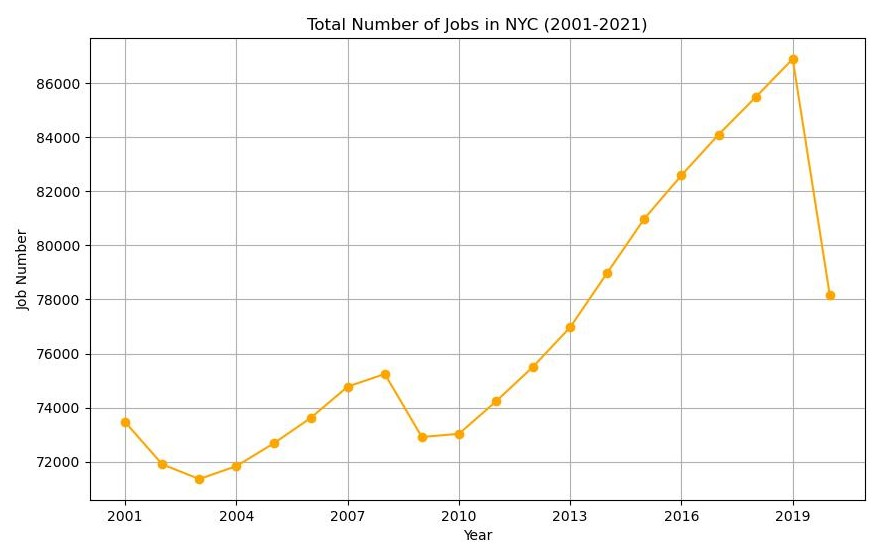

In [47]:
from IPython.display import Image

# Specify the path to your image file
image_path = 'acs/total_jobs_plot.jpg'

# Set the width of the displayed image (adjust the width value as needed)
width = 500

# Display the image with the specified width
Image(filename=image_path, width=width)


------------------------------------------------------------

Geographically, from 2019 to 2022, all counties in NYC metro region suffer a decrease in work position. The entire region loses 513,813 jobs. 65.6% job decrease is in Manhatten, the economic core of the region.

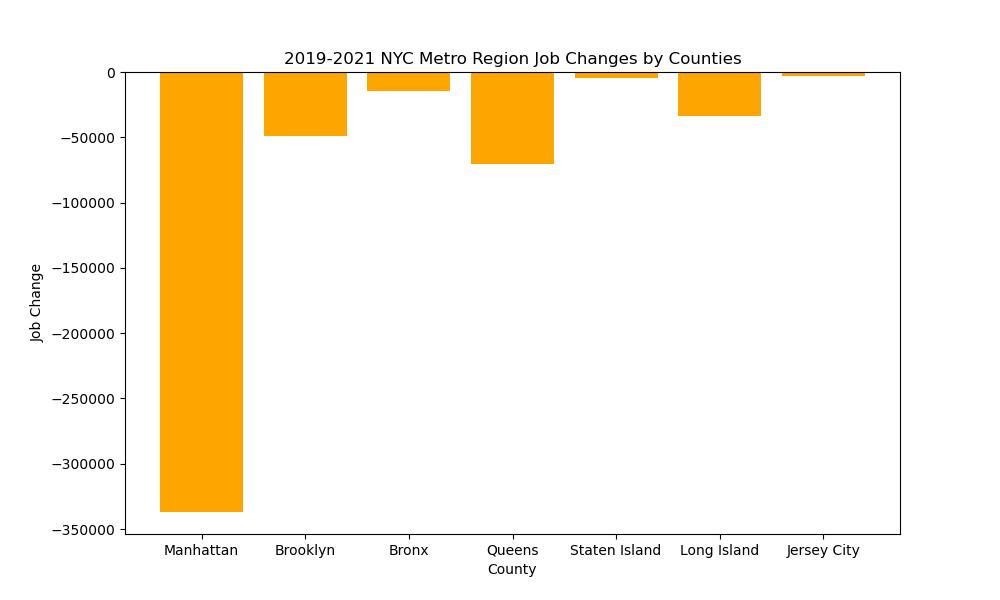

In [46]:
# Specify the path to your image file
image_path = 'acs/county_job_graph.jpg'

# Set the width of the displayed image (adjust the width value as needed)
width = 500

# Display the image with the specified width
Image(filename=image_path, width=width)

In [25]:
map_w_19 = w_19_gdf.hvplot(
    c="S000",
    geo=True,
    crs=2263,
    cmap="viridis",
    hover_cols=["S000"],
    dynamic=False,
    frame_width=350,
    frame_height=350,
    logz=True,  # Set log scale for color mapping
    line_width=0.05,  # Adjust line width for census tract borders
).opts(title="Employment Map LODES (Year 2019)")

In [27]:
map_w_21 = w_21_gdf.hvplot(
    c="S000",
    geo=True,
    crs=2263,
    cmap="viridis",
    hover_cols=["S000"],
    dynamic=False,
    frame_width=350,
    frame_height=350,
    logz=True,  # Set log scale for color mapping
    line_width=0.05,  # Adjust line width for census tract borders
).opts(title="Employment Map LODES (Year 2021)")

The employment number is calculated by the total job number in each census tract from LODES dataset. As the map below shows, the overall employment number distribution is roughly the same before and after the pandemic. Considering the size of census tract, employment is concentrated at Midtown and Downtown Manhattan and downtown Brooklyn. 

In [28]:
#| echo: true
#| code-fold: true
map_w_19 + map_w_21

:Layout
   .Polygons.I  :Polygons   [Longitude,Latitude]   (S000)
   .Polygons.II :Polygons   [Longitude,Latitude]   (S000)

## 2. Middle-age Labor Force Age

In [29]:
map_w_21_age = w_21_gdf.hvplot(
    c="SA02_Pct",
    geo=True,
    crs=2263,
    cmap="coolwarm",
    hover_cols=["SA02_Pct"],
    dynamic=False,
    frame_width=350,
    frame_height=350,
    # logz=True,  # Set log scale for color mapping
    line_width=0.05,  # Adjust line width for census tract borders
).opts(title="Middle-age Labor Force Map (Year 2021)")

In [30]:
map_w_19_age = w_19_gdf.hvplot(
    c="SA02_Pct",
    geo=True,
    crs=2263,
    cmap="coolwarm",
    hover_cols=["SA02_Pct"],
    dynamic=False,
    frame_width=350,
    frame_height=350,
    # logz=True,  # Set log scale for color mapping
    line_width=0.05,  # Adjust line width for census tract borders
).opts(title="Middle-age Labor Force Map (Year 2019)")

Here, we calculated the middle-age labor force (age 30-54) percentage to explore the labor force age structure. We guess that the younger employees have higher will to commute longer distance for work, which might be an importance variable to predict the commute distance.

For both year 2019 and 2021, the middle-age labor force tend to work within the city, while the suburbs, such as Long Island and Staten Island have a lower percentage of middle-age labor force. We also found that, compared to pre-COVID time, there is a higher proportion of middle-age work force in suburban areas. It might be a result of the emerging WFH working pattern and lower housing price of suburbs.

In [31]:
#| echo: true
#| code-fold: true
map_w_19_age + map_w_21_age

:Layout
   .Polygons.I  :Polygons   [Longitude,Latitude]   (SA02_Pct)
   .Polygons.II :Polygons   [Longitude,Latitude]   (SA02_Pct)

## 3. Income

In [38]:
map_w_19_low_income = w_19_gdf.hvplot(
    c="SE01_Pct",
    geo=True,
    crs=2263,
    cmap="RdYlBu",
    hover_cols=["SE01_Pct"],
    dynamic=False,
    frame_width=350,
    frame_height=350,
    #logz=True,  # Set log scale for color mapping
    line_width=0.05,  # Adjust line width for census tract borders
).opts(title="Low Income Census Tract (Year 2019)")

In [39]:
map_w_21_low_income = w_21_gdf.hvplot(
    c="SE01_Pct",
    geo=True,
    crs=2263,
    cmap="RdYlBu",
    hover_cols=["SE01_Pct"],
    dynamic=False,
    frame_width=350,
    frame_height=350,
    #logz=True,  # Set log scale for color mapping
    line_width=0.05,  # Adjust line width for census tract borders
).opts(title="Low Income Census Tract (Year 2021)")

In these two maps, we try to compare the low income ($1,250/month or less) jobs proportion. For both year 2019 and 2021, New York City, especially Manhattan, provides more high-paying jobs than suburbs like Long Island, Staten Island and Jersey City. From 2019 to 2021, there are more low-paying jobs across the metro area, especially for the surrouding area. 

In [40]:
#| echo: true
#| code-fold: true
map_w_19_low_income + map_w_21_low_income

:Layout
   .Polygons.I  :Polygons   [Longitude,Latitude]   (SE01_Pct)
   .Polygons.II :Polygons   [Longitude,Latitude]   (SE01_Pct)

## 4. Service Industry

In [41]:
map_w_21_service = w_21_gdf.hvplot(
    c="SI03_Pct",
    geo=True,
    crs=2263,
    cmap="RdYlBu",
    hover_cols=["SI03_Pct"],
    dynamic=False,
    frame_width=350,
    frame_height=350,
    #logz=True,  # Set log scale for color mapping
    line_width=0.05,  # Adjust line width for census tract borders
).opts(title="Service Employment Concentrated Census Tract (Year 2021)")

In [42]:
map_w_19_service = w_19_gdf.hvplot(
    c="SI03_Pct",
    geo=True,
    crs=2263,
    cmap="RdYlBu",
    hover_cols=["SI03_Pct"],
    dynamic=False,
    frame_width=350,
    frame_height=350,
    #logz=True,  # Set log scale for color mapping
    line_width=0.05,  # Adjust line width for census tract borders
).opts(title="Service Employment Concentrated Census Tract (Year 2019)")

LODES dataset classifies the industries into (1) Goods Producing; (2) Trade, Transportation, and Utilities; and  (3) All Other Services. Among them, service industry is mainly concentrated at the city. But south Bronx, north Brooklyn and south Queens are in low proportion of service industry. 

In [56]:
#| echo: true
#| code-fold: true
map_w_19_service + map_w_21_service

:Layout
   .Polygons.I  :Polygons   [Longitude,Latitude]   (SI03_Pct)
   .Polygons.II :Polygons   [Longitude,Latitude]   (SI03_Pct)

## 5. Population Density

In this step, we use  ACSDT5Y2021ACS and ACSDT5Y2019 data to explore the jobs change in NYC metro region. From 2019 to 2022, the total population in NYC metro region increases 342,629. Looking at population density maps,  the  rapid population growth areas are Brooklyn, Queens and Staten Island.

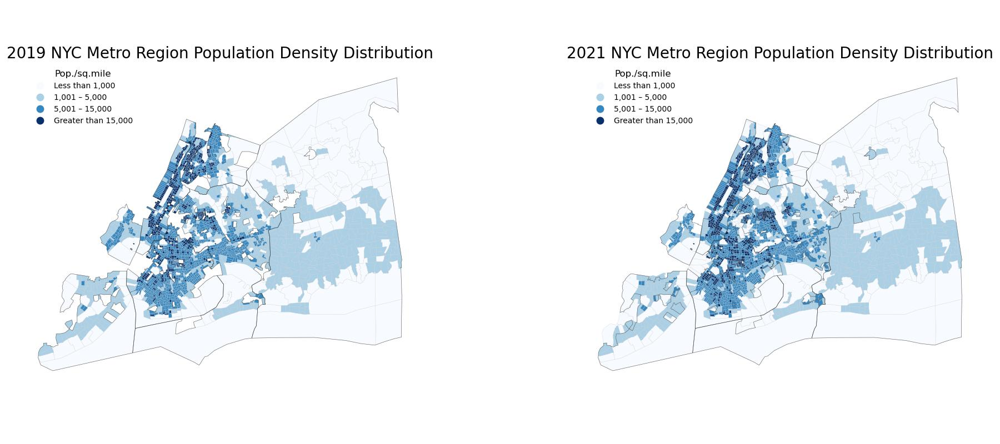

In [49]:
# Specify the path to your image file
image_path = 'acs/population_comparison.jpg'

# Set the width of the displayed image (adjust the width value as needed)
width = 800

# Display the image with the specified width
Image(filename=image_path, width=width)

## 6. Home Distribution

In [68]:
map_h_19 = h_19_gdf.hvplot(
    c="S000",
    geo=True,
    crs=2263,
    cmap="Blues",
    hover_cols=["S000"],
    dynamic=False,
    frame_width=350,
    frame_height=350,
    logz=True,  # Set log scale for color mapping
    line_width=0.05,  # Adjust line width for census tract borders
).opts(title="Home Map LODES (Year 2019)")

In [69]:
map_h_21 = h_21_gdf.hvplot(
    c="S000",
    geo=True,
    crs=2263,
    cmap="Blues",
    hover_cols=["S000"],
    dynamic=False,
    frame_width=350,
    frame_height=350,
    logz=True,  # Set log scale for color mapping
    line_width=0.05,  # Adjust line width for census tract borders
).opts(title="Home Map LODES (Year 2021)")

More people are moving to the cheaper suburban area.

In [70]:
#| echo: true
#| code-fold: true
map_h_19 + map_h_21

:Layout
   .Polygons.I  :Polygons   [Longitude,Latitude]   (S000)
   .Polygons.II :Polygons   [Longitude,Latitude]   (S000)

## 7. Median Housing Value

From 2019 to 2021, the housing prices rise across the entire NYC metro region, especially in Staten Island, Queens, Long Island and Brooklyn. 

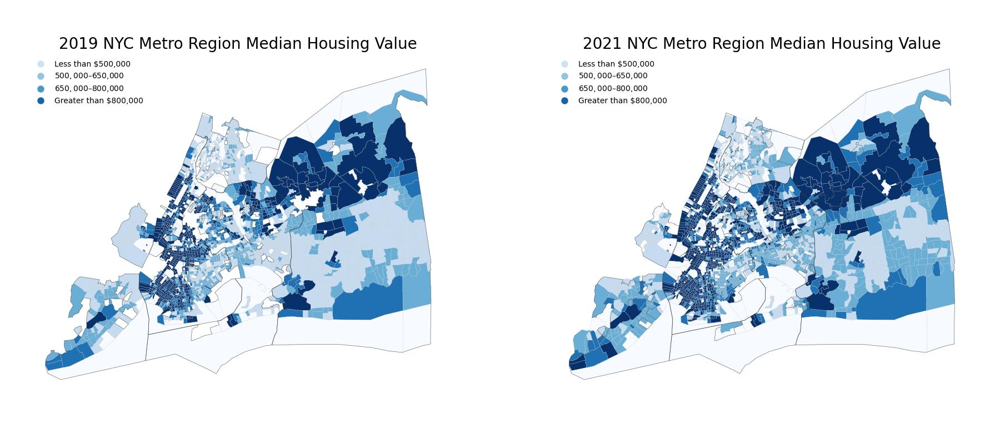

In [58]:
# Specify the path to your image file
image_path = 'acs/housing_value_comparison.jpg'

# Set the width of the displayed image (adjust the width value as needed)
width = 800

# Display the image with the specified width
Image(filename=image_path, width=width)

However, looking at the housing prices change rate, South Long Island, Brooklyne, Jersey City, Queens increase the most.

In [71]:
acs_merge = gpd.read_file('acs/acs_merge.geojson')

map_value_change_rate =acs_merge.hvplot(
    c="house_value_change_rate",
    geo=True,
    crs=2263,
    cmap="Blues",
    hover_cols=["house_value_change_rate"],
    dynamic=False,
    frame_width=600,
    frame_height=600,
    clim=(0,0.3), 
    # logz=True,  # Set log scale for color mapping
    line_width=0.1,  # Adjust line width for census tract borders
).opts(title="2019-2021 NYC Metro Region Median House Value Change Rate")
map_value_change_rate

:Polygons   [Longitude,Latitude]   (house_value_change_rate)

## 8. Tenure

In [74]:
import folium
from folium import plugins

In [72]:
acs19_gdf_own_rate = gpd.read_file('acs/acs19_gdf_own_rate.geojson')
acs21_gdf_own_rate = gpd.read_file('acs/acs21_gdf_own_rate.geojson')

The closer the settlement is situated to the NYC metro region boundaries, the higher the proportion of owner-occupied housing is, which is somewhat related to the relatively low house values.

In [75]:
# Create a Folium map centered around the mean of the geometry
m = acs19_gdf_own_rate.explore(
    column="own_rate", 
    cmap="Blues", 
    tiles="CartoDB positron", 
    vmin=0, 
    vmax=1,   
    style_kwds={
        "weight": 0.5, 
    }
)

# Add a title
title_html = '<h3 align="center" style="font-size:20px"><b>2019 NYC Metro Region Housing Ownership Rate</b></h3>'
m.get_root().html.add_child(folium.Element(title_html))

# Show the map
m

------------------------------------------------------

In [76]:
# Create a Folium map centered around the mean of the geometry
m = acs21_gdf_own_rate.explore(
    column="own_rate", 
    cmap="Blues",  
    tiles="CartoDB positron",  
    vmin=0, 
    vmax=1,   
    style_kwds={
        "weight": 0.5, 
    }
)

# Add a title
title_html = '<h3 align="center" style="font-size:20px"><b>2021 NYC Metro Region Housing Ownership Rate</b></h3>'
m.get_root().html.add_child(folium.Element(title_html))

# Show the map
m